# Pre-Columbian forest gardens span 180 km² in Bolivia’s Iténez preserve

Nicolas Gauthier [](https://orcid.org/0000-0002-2225-5827) (Florida Museum of Natural History, University of Florida)

The Iténez Forest Preserve in the Bolivian Amazon spans 4,000 km² between two of South America’s most significant archaeological landscapes—yet until now it remained unmapped, a blank spot between lowland Bolivia and the Brazilian Amazon. Using satellite imagery from the driest months on record and an AI-assisted detection system, I identified 180 km² of anthropogenic soils and forest gardens across the preserve. These features, connected by dense networks of earthworks that remain to be fully mapped, reveal organized landscape modification on a scale comparable to the region’s famous earthwork complexes. The findings demonstrate how ancient peoples transformed rainforest into productive cultural landscapes whose ecological signatures persist today, with local communities continuing to harvest cacao and other useful species from these anthropogenic forests. This work illustrates how AI can support—but not replace—human expertise in archaeological detection at regional scales.

In [ ]:
library(here)

here() starts at /Users/nick/UFL Dropbox/Nicolas Gauthier/Projects/itenez

── Attaching core tidyverse packages ──────────────────────── tidyverse 2.0.0 ──
✔ dplyr     1.1.4     ✔ readr     2.1.5
✔ forcats   1.0.0     ✔ stringr   1.5.1
✔ ggplot2   3.5.2     ✔ tibble    3.3.0
✔ lubridate 1.9.4     ✔ tidyr     1.3.1
✔ purrr     1.0.4     

── Conflicts ────────────────────────────────────────── tidyverse_conflicts() ──
✖ dplyr::filter() masks stats::filter()
✖ dplyr::lag()    masks stats::lag()
ℹ Use the conflicted package (<http://conflicted.r-lib.org/>) to force all conflicts to become errors


Attaching package: 'yardstick'

The following object is masked from 'package:readr':

    spec

Linking to GEOS 3.13.0, GDAL 3.8.5, PROJ 9.5.1; sf_use_s2() is TRUE


Attaching package: 'tidyterra'

The following object is masked from 'package:stats':

    filter


Attaching package: 'jsonlite'

The following object is masked from 'package:purrr':

    flatten

Linking to: OpenSSL 3.3.2 3 Sep 2024

## Introduction

For decades, a 4,000 km² void has persisted in archaeological maps of the Amazon, separating the well-studied earthwork landscapes of Bolivia from the forests of the Brazilian Amazon. The Iténez Forest Preserve occupies this glaring gap along the Bolivia-Brazil border. Located along the Bolivia-Brazil border between the extensively studied earthwork landscapes of the Bolivian lowlands and the forests of the Brazilian Amazon, this 4,000 km² expanse of forest remained largely unmapped by archaeologists. While important studies have documented sites at the preserve’s northern and southern margins ([Robinson et al. 2021](#ref-robinson2021); [Prümers, Jaimes Betancourt, and Plaza Martinez 2023](#ref-prümers2023); [Carson et al. 2016](#ref-carson2016pre)) , the rugged interior—the vast majority of this territory—has remained archaeologically unknown. Dense canopy cover, remoteness, and lack of prior survey work in the interior left it a blank spot on regional maps—a void in our understanding of southwestern Amazonian prehistory. Its position between known centers of pre-Columbian engineering ([Peripato et al. 2023](#ref-peripato2023); [De Souza et al. 2018](#ref-desouza2018)), however, suggested it might hold similar evidence of ancient landscape modification.

This study fills that gap through systematic remote sensing analysis, revealing extensive anthropogenic landscapes hidden beneath the forest canopy. The work focuses specifically on detecting Amazonian Dark Earth (ADE) and associated forest gardens—patches of modified forest composition that mark ancient settlements and agricultural areas ([Schmidt et al. 2014](#ref-schmidt2014); [Palace et al. 2017](#ref-palace2017); [Goldberg et al. 2024](#ref-goldberg2024)) . While earthworks are noted where visible, comprehensive mapping of these features beneath the canopy remains for future work. This approach prioritizes the detection of anthropogenic soils and forest composition changes that represent the primary evidence of human landscape transformation in continuously forested regions.

<figure>
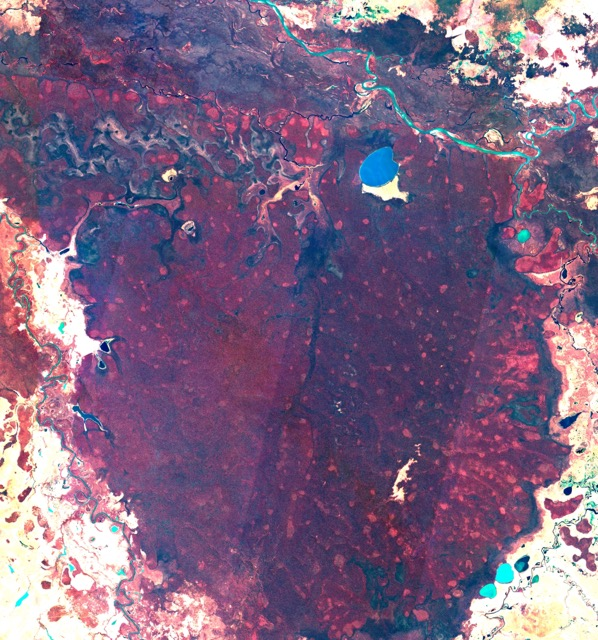
<figcaption aria-hidden="true">Sentinel-2 false color image composite of Itenez Forest Preserve from summer 2023. Light red spots indicate drier , lowcanopy vegetation associated with anthropogenic forest gardens (palms, cacao, bamboo, and other economically useful plants).</figcaption>
</figure>

The detection of these features at regional scale required developing new methodological approaches that combine AI-assisted pattern recognition with expert archaeological interpretation—a partnership where computational tools support but do not replace human expertise in identifying and mapping cultural landscapes.

## Methods

### Image Selection and Processing

I selected Sentinel-2 imagery ([European Union/ESA/Copernicus 2017](#ref-copernicus_s2_sr_harmonized)) from the driest periods in the satellite record (late summer 2023 and 2024), when reduced vegetation moisture and seasonal leaf loss maximize visibility of underlying soil and vegetation patterns. Cloud-free mosaics were processed in Google Earth Engine, combined with a state of the art regional canopy height model ([Wagner et al. 2025](#ref-wagner2025highresolutiontreeheight)) to distinguish anthropogenic forest structures from natural variation.

In [ ]:
plot_nth_set_gg(triplets, 58)

The imagery was exported as multi-scale tiles (512, 768, and 1024 pixels) with band combinations optimized to highlight spectral signatures of ADE and modified forest. These signatures reflect the distinct ecological characteristics of anthropogenic landscapes: more open canopy structure, seasonal deciduousness, high concentrations of useful plants (palms, bamboos, cacao), and altered soil chemistry from centuries of human occupation and management Robinson et al. ([2021](#ref-robinson2021)).

<figure>
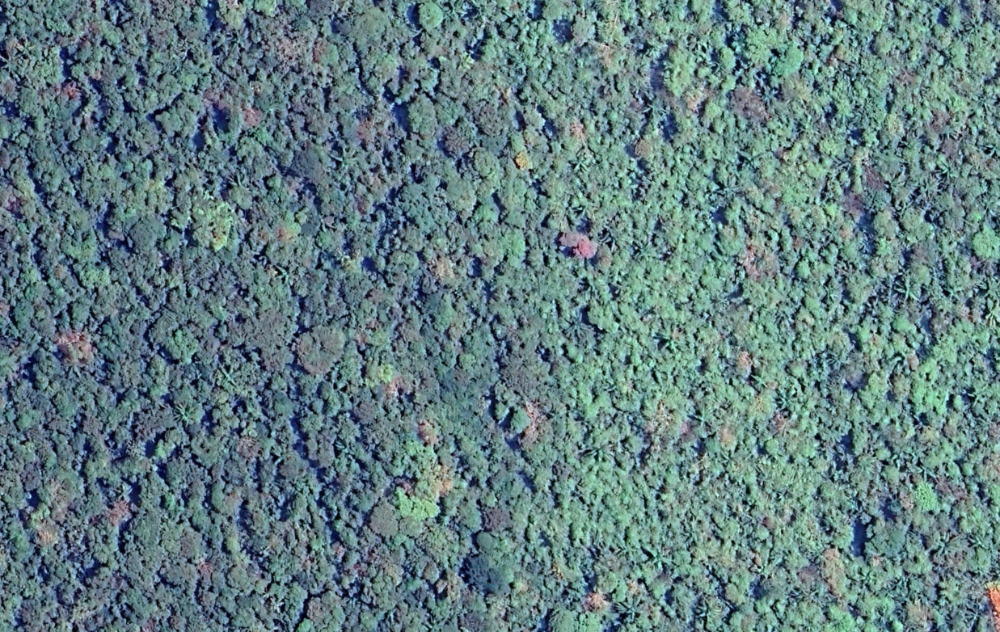
<figcaption aria-hidden="true">Detail of transition between natural forest vegetation (left) and anthropogenic forest (right). Not the lighter vegetation, lower canopy, and preponderance of palms and lianas.</figcaption>
</figure>

### Detection Workflow: Human-AI Partnership

I developed an agentic object detection system using GPT-4.1, and Moondream2 vision-language models to identify anthropogenic features at scale. This system serves as a detection and verification tool, supporting human expertise rather than replacing it. The workflow operates as follows:

1.  GPT models review imagery and generate initial hypotheses about feature locations based on spectral patterns and landscape context. They are prompted to view the landscape holistically, looking for patterns across multiple domains, rather than focusing on strict quantitative criteria.
2.  The primary models iteratively refine predictions through successive passes using a smaller, specialized vision language models tuned for object detection and grounding. These system lack the domain knowledge of the image contents, so the GPT agent must generate creative, abstract text prompts to detect all features in the scene (e.g. “reddish-pink spots”, “purple swirls”.
3.  The system produces point predictions marking potential anthropogenic sites
4.  These points guide large-scale verification and exploration of spatial patterns

**Examples:**

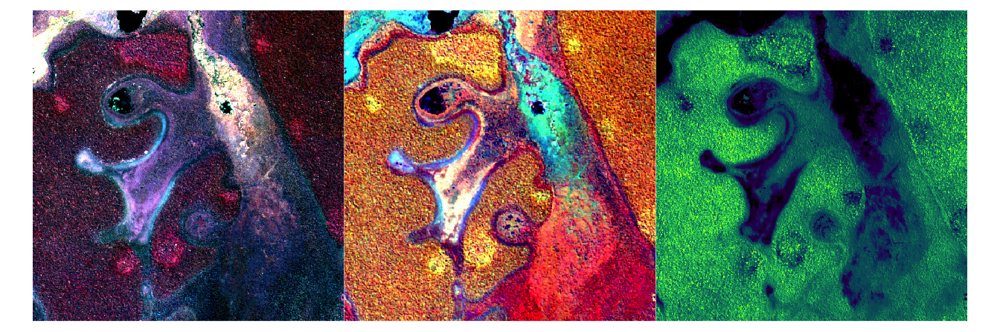

In [ ]:
plot_nth_set_gg(triplets, 59)

In [ ]:
agent_test1 <- detect_anthrosols(triplets[[59]], mode = 'gpt-4.1', echo = TRUE)

**Scene interpretation (Step 1):**

- **C1:** Several compact, lobate, and elliptical reddish-pink/magenta patches 
are visible, especially in the lower left and central portions. These are 
embedded within a mottled forest matrix, not at a forest/nonforest boundary. 
Some patches have faintly darker centers or are ringed, and a few are clustered
or aligned along subtle curvilinear features.
- **C2:** The same areas show strong yellow/orange signals, supporting the 
presence of stressed/drier vegetation consistent with ADE patches. The 
yellow/orange is compact and matches the C1 anomalies.
- **CHM:** The patches correspond to areas of lower canopy height 
(blue/purple), sometimes with a ring or edge effect, further supporting the 
interpretation as ADE patches.

**Spatial context:** The anomalies are compact, not diffuse, and are 
distributed in a pattern suggestive of anthropogenic origin (not random 
disturbance or natural clearing). There are at least 4–5 clear candidates, 
possibl

◯ [tool call] tool_001(prompt = "reddish-pink spots")

● #> [{"x":0.0918,"y":0.2998},{"x":0.292,"y":0.8223},{"x":0.4375,"y":0.7656},{…

◯ [tool call] tool_001(prompt = "magenta patches")

● #> [{"x":0.4404,"y":0.7637},{"x":0.2949,"y":0.8213},{"x":0.0918,"y":0.2998},…

◯ [tool call] tool_001(prompt = "lobate red blobs")

● #> [{"x":0.0918,"y":0.3037},{"x":0.2959,"y":0.8213},{"x":0.4365,"y":0.7666},…

**Synthesis of Moondream points:**

- All three prompts ("reddish-pink spots", "magenta patches", "lobate red 
blobs") returned highly consistent results, with 6–7 points each and strong 
spatial overlap.
- After removing redundant points (within a few pixels of each other), there 
are 7 distinct, compact patch locations:
  1. (0.0918, 0.300) — Lower left, compact patch
  2. (0.296, 0.821) — Lower central, lobate patch
  3. (0.438, 0.766) — Lower central-right, elliptical patch
  4. (0.630, 0.598) — Central, lobate patch
  5. (0.734, 0.109) — Upper central, compact patch
  6. (0.847, 0.381) — Upper right, compact patch
  7. (0.968, 0.671) — Far right edge, compact patch (less certain, but 
contextually plausible)

- All points correspond to compact, non-diffuse anomalies with dual spectral 
support (C1: reddish/magenta, C2: yellow/orange) and CHM support (lower 
canopy).
- No points are at forest/nonforest boundaries; all are within continuous 
forest matrix or at plausible bluff/settl

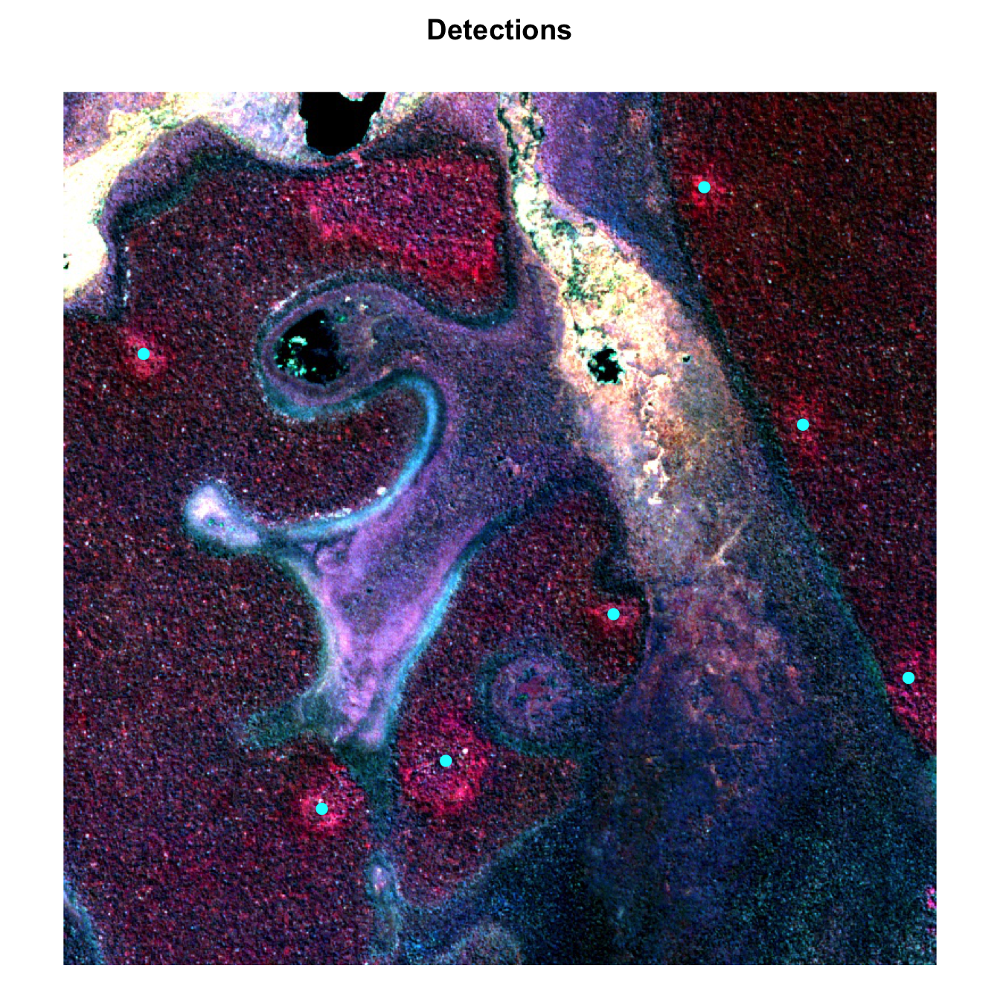

In [ ]:
plot_detections(agent_test1)

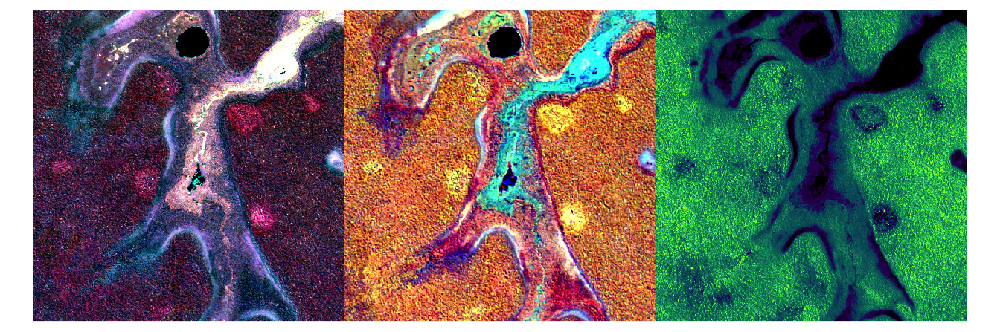

In [ ]:
plot_nth_set_gg(triplets, 58)

In [ ]:
agent_test2 <- detect_anthrosols(triplets[[58]], mode = 'gpt-4.1', echo = TRUE)

**Scene interpretation (Step 1):**

- **C1:** Several compact, bright reddish-pink/magenta patches are visible, 
especially to the right of the main river channel and in the upper right 
quadrant. These are distinct from the surrounding mottled forest matrix and are
not simply forest-nonforest boundaries. Their form is compact and lobate, not 
diffuse.
- **C2:** These same areas correspond to bright yellow/orange splotches, 
indicating low transpiration/drier canopy, supporting the ADE patch hypothesis.
- **CHM:** The candidate patches show subtle but clear lower-canopy zones, 
sometimes as rings or compact cores, consistent with ADE vegetation structure.

**Spatial context:** The anomalies are within continuous forest, not at the 
edge of floodplain or clearings, and are aligned with bluff edges and drainage 
patterns—classic ADE context.

**Initial expert estimate:** There are at least 3–5 plausible ADE patches in 
this scene, mainly in the right half and upper right quadrant, with p

◯ [tool call] tool_002(prompt = "reddish-pink spots")

● #> [{"x":0.7393,"y":0.6631},{"x":0.6777,"y":0.3467},{"x":0.8906,"y":0.3037},…

◯ [tool call] tool_002(prompt = "large magenta patch")

● #> [{"x":0.7344,"y":0.668}]

**Synthesis (Step 3):**

- Both prompts ("reddish-pink spots", "large magenta patch") returned 
overlapping results, with the "reddish-pink spots" prompt identifying 7 points 
and the "large magenta patch" prompt confirming the main patch at (0.7344, 
0.668).
- After removing redundancies, there are 7 distinct candidate patches. Most are
in the right half of the image, matching compact, bright magenta/yellow 
anomalies with supporting CHM structure.
- All selected points are within continuous forest, not at the edge or in 
clearings, and show dual spectral and structural support.
- No points are spurious small blobs or forest-nonforest boundaries.

**Ready for final synthesis.**

DONE.

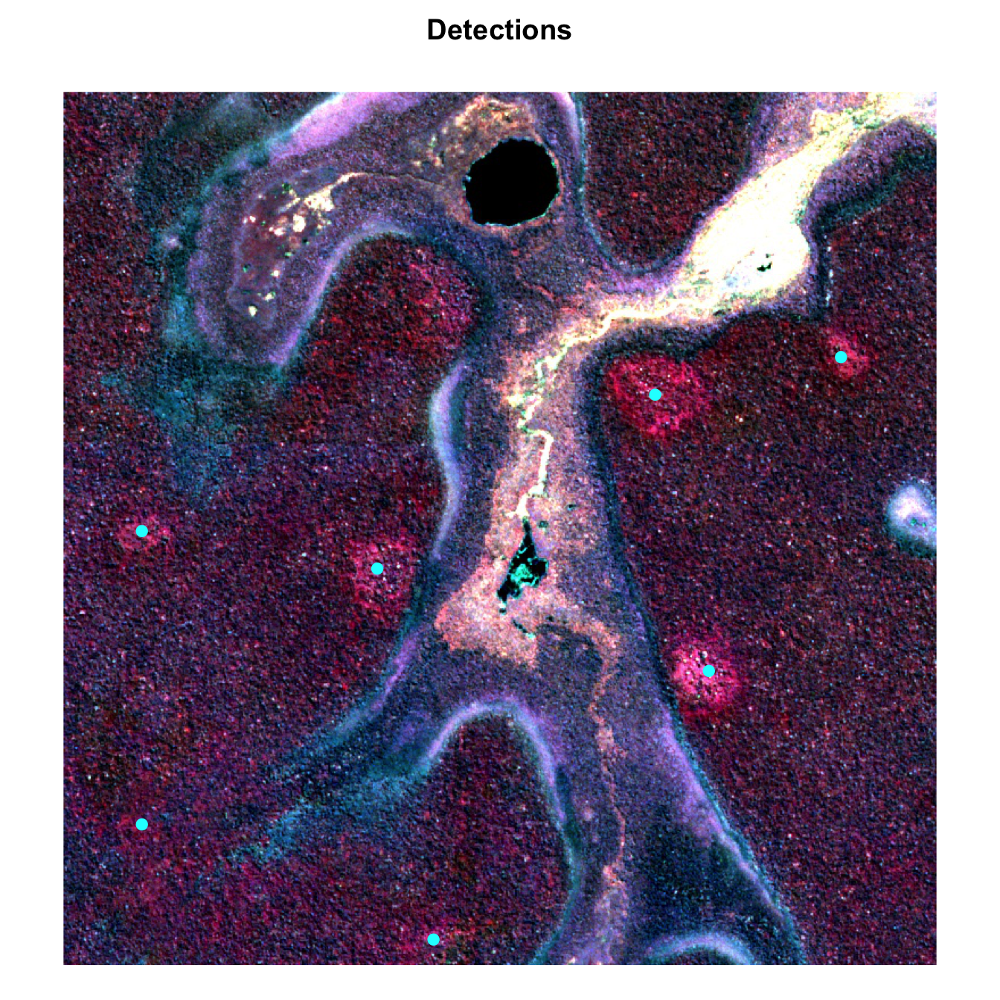

In [ ]:
plot_detections(agent_test2)

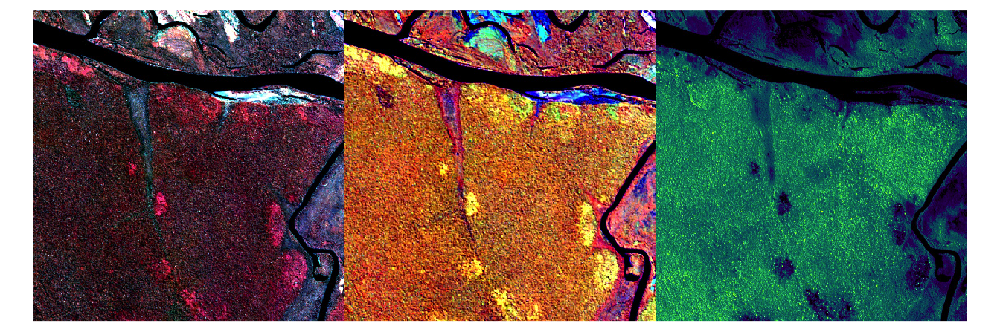

In [ ]:
plot_nth_set_gg(triplets, 50)

In [ ]:
agent_test3 <- detect_anthrosols(triplets[[50]], mode = 'gpt-4.1', echo = TRUE)

**Scene interpretation (Step 1):**

- **C1:** Several compact, lobate, reddish-pink/magenta patches are visible, 
especially in the lower center and right-center of the image. These patches are
embedded within a continuous forest matrix and are not simply forest-nonforest 
boundaries. Their form is compact and clustered, not diffuse.
- **C2:** The same areas show strong yellow/orange splotches, supporting the 
interpretation of stressed/drier vegetation typical of ADE patches.
- **CHM:** These patches correspond to areas of slightly lower canopy height, 
sometimes with a ringed or clustered structure, further supporting the ADE 
hypothesis.

**Spatial context:** The anomalies are set back from the river bluff, not on 
the floodplain, and are not simple clearings or recent disturbances. Their size
and form are consistent with ADE patches (≥5 ha, compact, not linear or 
diffuse).

**Initial expert estimate:** There are approximately 7–9 distinct ADE-like 
patches in this scene, mostly in

◯ [tool call] tool_003(prompt = "reddish-pink spots")

● #> [{"x":0.4102,"y":0.6172},{"x":0.4121,"y":0.8291},{"x":0.5,"y":0.9248},{"x…

◯ [tool call] tool_003(prompt = "magenta patches")

● #> [{"x":0.4092,"y":0.6172},{"x":0.4092,"y":0.8291},{"x":0.5,"y":0.9248},{"x…

**Synthesis (Step 3):**

- Both prompts ("reddish-pink spots", "magenta patches") returned highly 
overlapping sets of points, confirming the main compact anomalies.
- After removing redundant/overlapping points and excluding those at the 
extreme image edge or lacking clear dual spectral/structural support, I 
identify **9 distinct ADE-like patches**:
  - Lower center and lower right: 4 patches (clustered, strong spectral/CHM 
support)
  - Right-center: 2 patches (compact, clear dual support)
  - Center: 1 patch (well-defined, strong support)
  - Upper right: 1 patch (less prominent but fits context)
  - Lower left: 1 patch (smaller but meets size/context criteria)
- All selected patches are compact, ≥5 ha, and show strong dual spectral and 
CHM support, with plausible ADE context (not floodplain, not recent 
disturbance, not forest-nonforest boundary).

**Summary of synthesis:**
- Used two prompts, results highly consistent.
- Removed duplicates and edge-only points.
- All final poin

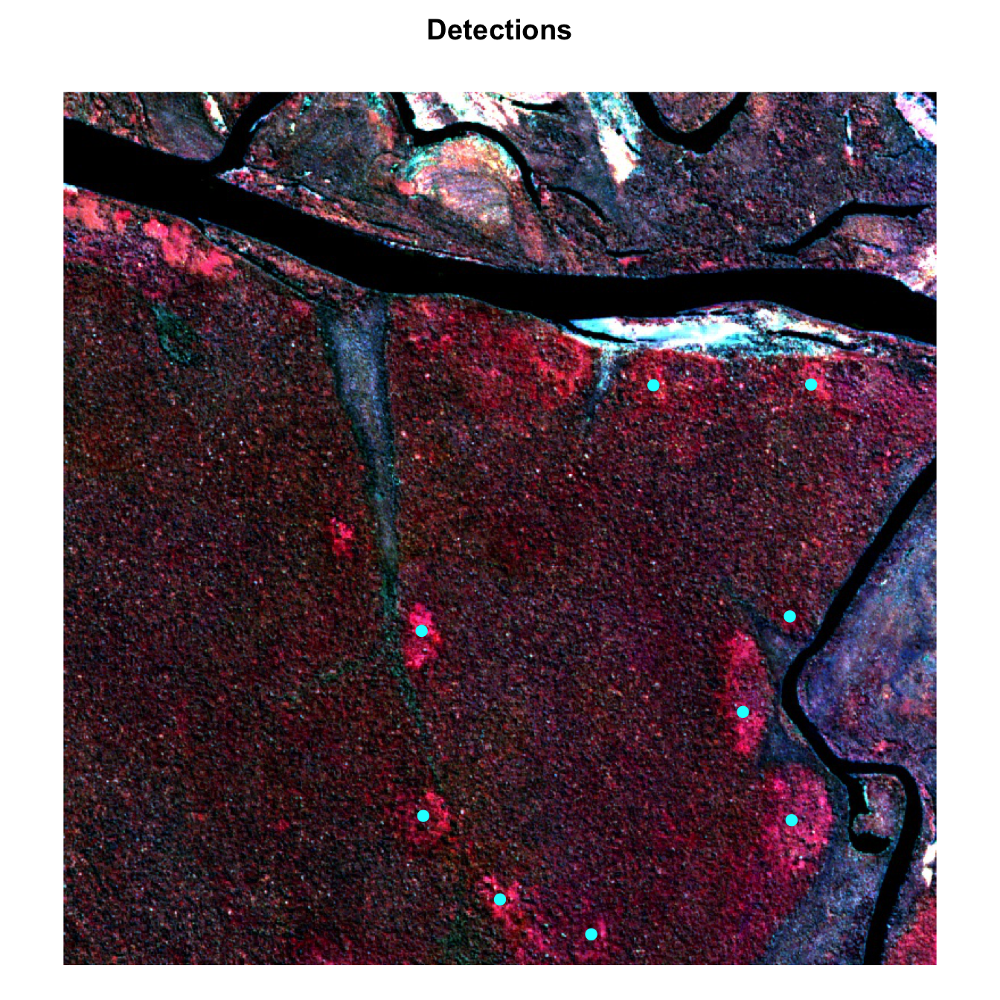

In [ ]:
plot_detections(agent_test3)

Critically, this AI component operated in parallel with detailed manual mapping. I meticulously reviewed and labeled hundreds of polygon boundaries over anthropogenic forest patches through careful imagery analysis, with the AI and manual mapping developing iteratively and informing each other. Earthworks—canals, ditches, and geometric earthworks—were recorded where visible through the canopy, though comprehensive mapping of these linear features remains a priority for future work with higher-resolution imagery. This approach allowed me to iteratively calibrate and validate the models’ ability to detect known archaeological features in zero-shot and few-shot learning contexts. The models were not fine-tuned but leveraged pre-trained capabilities to recognize visual patterns consistent with archaeological features. This approach exemplifies how AI can extend human capacity for regional-scale analysis without replacing the expertise necessary for accurate feature identification and interpretation.

## Results

The analysis **identified approximately 180 km² of anthropogenic soils and forest gardens within the Iténez Forest Preserve, representing 5% of its total area—comparable to the footprint of many modern world cities**, though distributed as a network of patches rather than a contiguous area. I mapped over 350 individual fields ranging from 5 to 700 hectares, with clear spatial clustering along bluffs, drainages, and floodplain margins in upland *terra firme* forest—confirming hypotheses about bluff-edge settlement systems previously proposed for this region ([Denevan 1996](#ref-denevan1996)).

In [ ]:
anthrosols <- read_sf('data/derived/anthrosols.gpkg') |>
    mutate(area = units::set_units(st_area(geom), km2) |> units::drop_units())

mapview(anthrosols, basemaps = 'Esri.WorldImagery')


|---------|---------|---------|---------|
                                          

<SpatRaster> resampled to 500778 cells.

In [ ]:
convert_tile_points <- function(points_tibble, tile_geom) {
  # Get bounding box of the tile
  bbox <- st_bbox(tile_geom)
  # Convert normalized coordinates to spatial coordinates
  points_tibble %>%
    mutate(
      spatial_x = bbox["xmin"] + x * (bbox["xmax"] - bbox["xmin"]),
      spatial_y = bbox["ymin"] + y * (bbox["ymax"] - bbox["ymin"])
    )
}

combine_all_points <- function(points_list, tiles_list) {
  # Convert all and add tile index
  spatial_list <- map2(points_list, tiles_list, convert_tile_points) %>%
    imap(~ mutate(.x, tile_id = .y))  # Add tile identifier
  
  # Combine all tibbles
  all_points <- bind_rows(spatial_list)
  
  # Convert to sf using CRS from first tile
  all_points %>%
    st_as_sf(coords = c("spatial_x", "spatial_y"), 
             crs =4326)
}

agent_results <- readRDS(here('data/derived/moon_41.rds'))

agent_points <- map(agent_results, ~.x$result$points) |>
  combine_all_points(tiles$geom) |>
  select(-x, -y)

ggplot() +
  geom_spatraster_rgb(data = elev_tiles) +  # basemap
  geom_sf(data = st_centroid(anthrosols),fill = 'black') +
  geom_sf(data = agent_points, size = 1, color = 'red') +
  coord_sf(crs = st_crs(elev_tiles)) +
  theme_void()

<SpatRaster> resampled to 500778 cells.

The most striking discovery is a major complex spanning more than 4 kilometers, where large-scale fields connect through networks of earthworks. Across the mapped area, an exceptionally dense system of linear features links settlements into an integrated landscape. While full mapping of these earthworks awaits future work with canopy-penetrating sensors, their visible portions already demonstrate a level of landscape integration comparable to the most complex sites in neighboring regions.

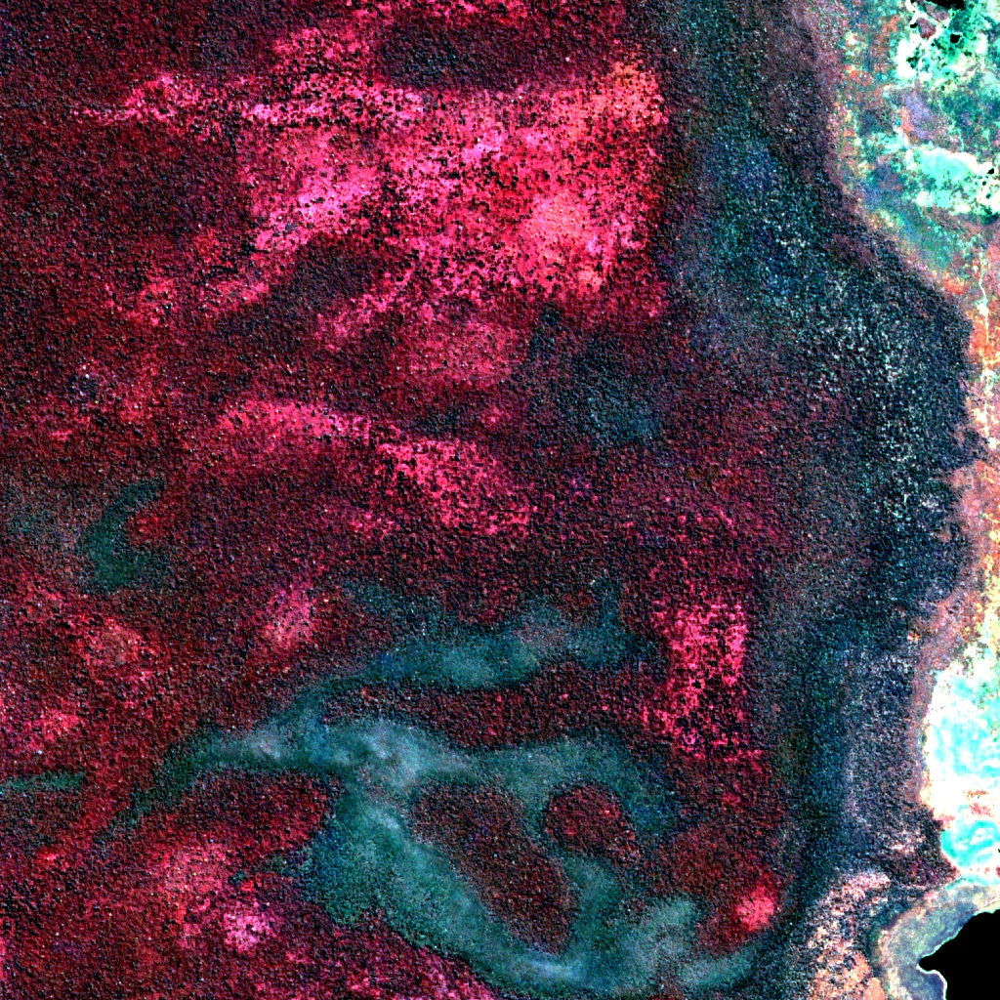

Rank-size analysis reveals a clear hierarchical structure in field sizes and site distribution, with the size distribution following a power law with an exponent close to 1 on log-log plots. This pattern, consistent with organized settlement systems, matches the scale and complexity documented in the Llanos de Mojos and Baures ([Prümers et al. 2022](#ref-prumers2022lidar); [Erickson 2000](#ref-erickson2000)). The largest sites anchor networks of settlement and agroforestry patches, suggesting centralized planning and resource management across the landscape.

`geom_smooth()` using formula = 'y ~ x'

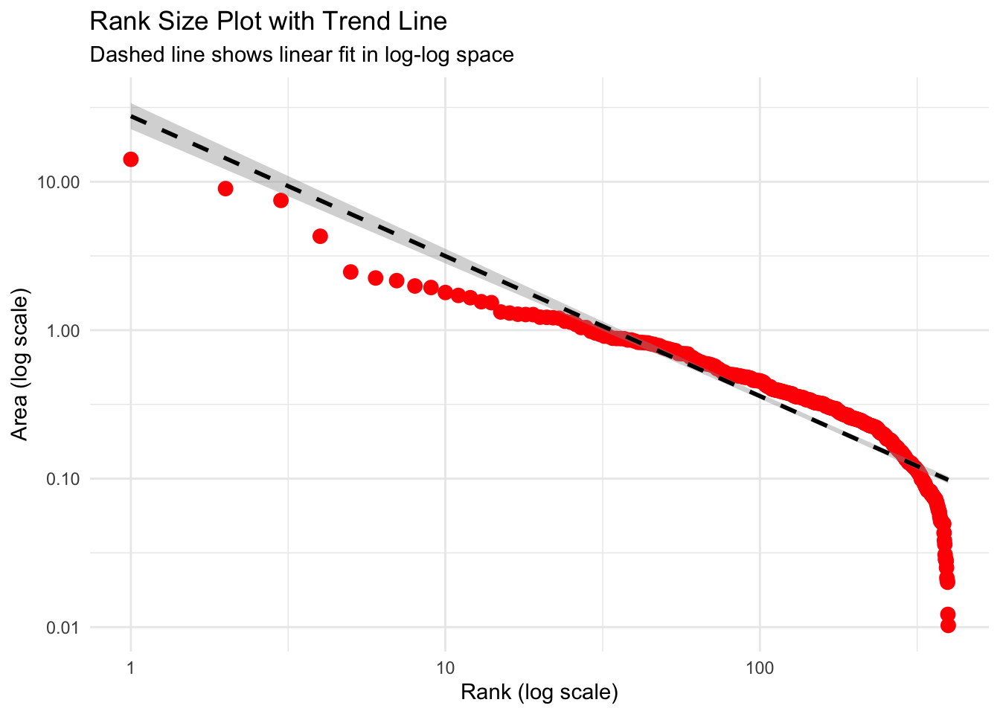

In [ ]:
# Prepare data for rank size plot
rank_size_data <- anthrosols %>%
  arrange(desc(area)) %>%
  mutate(rank = row_number())

# Add trend line to check for Zipf's law
ggplot(rank_size_data, aes(x = rank, y = area)) +
  geom_point(size = 3, color = "red") +
  geom_smooth(method = "lm", se = TRUE, color = "black", linetype = "dashed") +
  scale_x_log10() +
  scale_y_log10() +
  labs(title = "Rank Size Plot with Trend Line",
       x = "Rank (log scale)",
       y = "Area (log scale)",
       subtitle = "Dashed line shows linear fit in log-log space") +
  theme_minimal()

These anthropogenic landscapes remain ecologically distinct today. Forest composition in mapped areas shows high concentrations of economically useful species, particularly cacao, making the region a modern hotspot for wild cacao cultivation—a direct legacy of ancient land use practices ([Carson et al. 2016](#ref-carson2016pre)). Local and Indigenous communities continue to harvest these resources, underscoring that these are not merely archaeological sites but living landscapes where ancient management practices continue to shape both forest ecology and human livelihoods.

## Discussion

These findings transform our understanding of the Iténez region from archaeological blank spot to critical piece in the Amazonian puzzle. The extent and organization of anthropogenic landscapes documented here match or exceed those in better-studied areas, confirming that large-scale landscape engineering extended continuously across the southwestern Amazon. This fills the last major gap in the regional archaeological map between the Llanos de Mojos and Baures, revealing that the Iténez was not a periphery but an integral part of pre-Columbian regional systems.

The hierarchical site structure and extensive earthwork networks point to complex social organization capable of coordinating landscape modification across thousands of square kilometers. Rather than isolated communities practicing small-scale agriculture, the evidence suggests integrated regional systems linking settlements through engineered infrastructure and shared land management practices. The concentration of sites along bluff edges and floodplain margins confirms earlier hypotheses about settlement preferences in *terra firme* forests, while the scale revealed here exceeds previous expectations.

The ecological legacy of these ancient landscapes extends beyond their archaeological significance. Forest composition in mapped areas reflects centuries of human selection for useful species, creating patches of anthropogenic forest that blur the line between nature and culture. The continued harvesting of cacao and other products from these forests by contemporary communities represents an unbroken tradition of forest management extending from pre-Columbian times to the present. This continuity challenges us to recognize that the “pristine” forests we seek to conserve are themselves products of Indigenous innovation and management.

The successful detection of these features through combined AI and expert analysis demonstrates new possibilities for archaeological survey in forested regions. The human-AI partnership developed here—where computational tools assist in pattern detection while human expertise guides interpretation and mapping—offers a model for scaling archaeological survey across Amazonia’s vast forests. This approach proved particularly effective for identifying the subtle spectral signatures of anthropogenic soils and forest gardens that would be impossible to map at this scale through ground survey alone.

### Implications and Future Directions

This work contributes to the mounting evidence that the Amazon was extensively shaped by its pre-Columbian inhabitants, adding a major piece to our understanding of regional cultural landscapes. The Iténez landscapes join the growing inventory documented by recent synthetic works, while demonstrating that significant discoveries remain to be made even in the 21st century. The findings reinforce emerging models of pre-Columbian Amazonia as a mosaic of engineered landscapes rather than pristine wilderness punctuated by occasional cultural sites.

Future research should pursue several directions. First, LiDAR or high-resolution radar imagery could reveal the full extent of earthwork networks currently hidden beneath the canopy, allowing comprehensive mapping of the linear features only partially visible in optical imagery. Second, systematic field verification and dating would establish the chronology and cultural affiliations of these landscapes, potentially revealing connections to known archaeological cultures of the Llanos de Mojos and Baures. Third, detailed ecological studies of forest composition and soil properties would deepen our understanding of how ancient management practices created the anthropogenic forests that communities value today. The methodological approach developed here—combining AI-assisted detection with expert archaeological interpretation—offers broader applications for Amazonian archaeology. As we refine these tools, maintaining the balance between computational efficiency and human expertise will be critical. AI can help us see patterns across vast scales, but understanding what those patterns mean for human history requires archaeological knowledge that no algorithm can replace.

These findings also have immediate relevance for conservation planning. Protecting these forests means protecting both biodiversity and living Indigenous heritage—recognizing that the ecological richness we value today emerged from millennia of human management.

## Conclusion

The Iténez Forest Preserve emerges from this analysis not as pristine wilderness but as a cultural landscape shaped by centuries of Indigenous management. The 180 km² of mapped anthropogenic soils and forest gardens, connected by dense earthwork networks and organized in hierarchical patterns, demonstrate that pre-Columbian peoples transformed this region as extensively as anywhere in Amazonia. This work fills the last major blank spot in the archaeological map of the southwestern Amazon, revealing continuous cultural landscapes between previously studied regions.

These findings illustrate both the potential and limits of new technological approaches to archaeology. While AI-assisted detection enabled mapping at unprecedented scales, the interpretation and validation of these features required human expertise at every step. This partnership between computational tools and archaeological knowledge offers a path forward for understanding Amazonia’s human past across its vast forested expanses.

As we continue to reveal the Amazon’s deep human history, we gain essential perspective on its present and future. The forest gardens where communities harvest cacao today are living monuments to Indigenous landscape management, reminding us that the biodiversity we value emerged from millennia of human-forest interaction. Understanding this legacy is crucial not only for archaeology but for contemporary efforts to conserve and sustainably manage these cultural landscapes.

## Appendix

Comparison of tile-level site counts from observed data and zero-shot results from a variety of GPT models with and without agentic capability.

ℹ In argument: `centroids = lengths(st_intersects(geometry,
  st_centroid(anthrosols)))`.
Caused by warning:
! st_centroid assumes attributes are constant over geometries

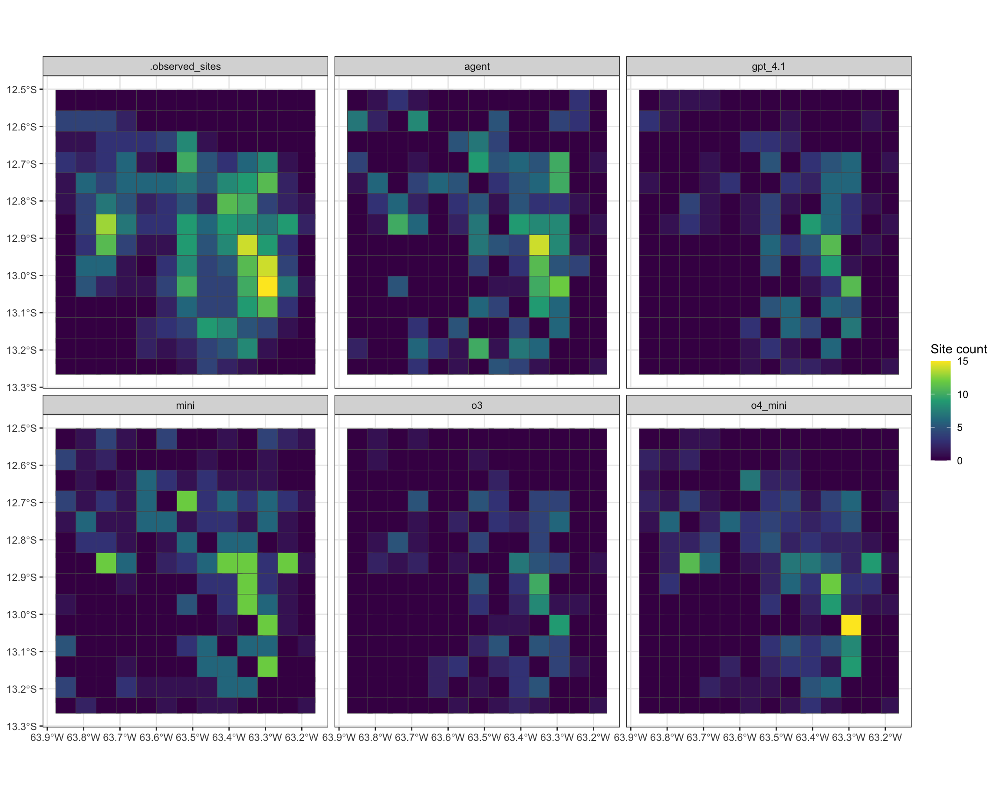

In [ ]:
results <- readRDS(here('data/derived/results.rds')) |>
  mutate(.truth = lengths(st_intersects(geometry, anthrosols)),
         centroids = lengths(st_intersects(geometry, st_centroid(anthrosols))),
         agent = map_dbl(agent_results, ~.x$result$count)
)

Performance metrics for zero-shot site detection:

In [ ]:
site_detection_metrics <- metric_set(accuracy, sens, spec, f_meas)

results |>
  select(-.truth) |>
  st_drop_geometry() |>
  pivot_longer(-c(id, centroids), names_to = 'model', values_to = 'estimate') |>
  group_by(model) |>
  mutate(estimate = factor(estimate > 0),
         truth = factor(centroids > 0)) |>
  site_detection_metrics(truth = truth, estimate = estimate, event_level = 'second') |>
  select(-.estimator) |>
  pivot_wider(names_from = .metric, values_from = .estimate) |>
  mutate(across(where(is.numeric), ~ round(.x, 3))) %>%
  arrange(desc(accuracy)) |>
  kableExtra::kable()

Performance metrics for zero-shot site counting:

In [ ]:
regression_metrics <- metric_set(rmse, mae, rsq)

results |>
  select(-.truth) |>
  st_drop_geometry() |>
  pivot_longer(-c(id, centroids), names_to = 'model', values_to = 'estimate') |>
  group_by(model) |>
  mutate(estimate = pmax(estimate, 1e-6)) |>
  regression_metrics(truth = centroids, estimate = estimate) |>
  select(-.estimator) |>
  pivot_wider(names_from = .metric, values_from = .estimate) |>
  mutate(across(where(is.numeric), ~ round(.x, 3))) %>%
  arrange(rmse) |>
  kableExtra::kable()

Carson, John F, Francis E Mayle, Bronwen S Whitney, José Iriarte, and J Daniel Soto. 2016. “Pre-Columbian Ring Ditch Construction and Land Use on a ‘Chocolate Forest Island’in the Bolivian Amazon.” *Journal of Quaternary Science* 31 (4): 337–47.

De Souza, Jonas Gregorio, Denise Pahl Schaan, Mark Robinson, Antonia Damasceno Barbosa, Luiz E. O. C. Aragão, Ben Hur Marimon, Beatriz Schwantes Marimon, et al. 2018. “Pre-Columbian Earth-Builders Settled Along the Entire Southern Rim of the Amazon.” *Nature Communications* 9 (1): 1125. <https://doi.org/10.1038/s41467-018-03510-7>.

Denevan, William M. 1996. “A Bluff Model of Riverine Settlement in Prehistoric Amazonia.” *Annals of the Association of American Geographers* 86 (4): 654–81. <https://doi.org/10.1111/j.1467-8306.1996.tb01771.x>.

Erickson, Clark L. 2000. “An Artificial Landscape-Scale Fishery in the Bolivian Amazon” 408.

European Union/ESA/Copernicus. 2017. “Harmonized Sentinel-2 MSI: MultiSpectral Instrument, Level-2A (SR).” Google Earth Engine. <https://developers.google.com/earth-engine/datasets/catalog/COPERNICUS_S2_SR_HARMONIZED>.

Goldberg, Samuel L., Morgan J. Schmidt, Joshua D. Himmelstein, Michael Heckenberger, Bruna Franchetto, Helena Lima, Jennifer Watling, et al. 2024. “Widespread Amazonian Dark Earth in the Xingu Indigenous Territory.” *Nature Sustainability* 7 (10): 1304–12. <https://doi.org/10.1038/s41893-024-01399-3>.

Heckenberger, Michael J., J. Christian Russell, Carlos Fausto, Joshua R. Toney, Morgan J. Schmidt, Edithe Pereira, Bruna Franchetto, and Afukaka Kuikuro. 2008. “Pre-Columbian Urbanism, Anthropogenic Landscapes, and the Future of the Amazon.” *Science* 321 (5893): 1214–17. <https://doi.org/10.1126/science.1159769>.

Palace, M. W., C. N. H. McMichael, B. H. Braswell, S. C. Hagen, M. B. Bush, E. Neves, E. Tamanaha, C. Herrick, and S. Frolking. 2017. “Ancient Amazonian Populations Left Lasting Impacts on Forest Structure.” *Ecosphere* 8 (12): e02035. <https://doi.org/10.1002/ecs2.2035>.

Peripato, Vinicius, Carolina Levis, Guido A. Moreira, Dani Gamerman, Hans Ter Steege, Nigel C. A. Pitman, Jonas G. De Souza, et al. 2023. “More Than 10,000 Pre-Columbian Earthworks Are Still Hidden Throughout Amazonia.” *Science* 382 (6666): 103–9. <https://doi.org/10.1126/science.ade2541>.

Prümers, Heiko, Carla Jaimes Betancourt, José Iriarte, Mark Robinson, and Martin Schaich. 2022. “Lidar Reveals Pre-Hispanic Low-Density Urbanism in the Bolivian Amazon.” *Nature* 606 (7913): 325–28.

Prümers, Heiko, Carla Jaimes Betancourt, and Ruden Plaza Martinez. 2023. “Algunas tumbas prehispánicas de Bella Vista, Prov. Iténez, Bolivia.” *Zeitschrift für Archäologie Außereuropäischer Kulturen*, August, 251284 Seiten. <https://doi.org/10.34780/AKD6-046J>.

Robinson, Mark, Carla Jaimes-Betancourt, Sarah Elliott, S. Yoshi Maezumi, Lautaro Hilbert, Daiana Alves, Jonas Gregorio De Souza, and José Iriarte. 2021. “Anthropogenic Soil and Settlement Organisation in the Bolivian Amazon.” *Geoarchaeology* 36 (3): 388–403. <https://doi.org/10.1002/gea.21839>.

Schmidt, Morgan J., Anne Rapp Py-Daniel, Claide De Paula Moraes, Raoni B. M. Valle, Caroline F. Caromano, Wenceslau G. Texeira, Carlos A. Barbosa, et al. 2014. “Dark Earths and the Human Built Landscape in Amazonia: A Widespread Pattern of Anthrosol Formation.” *Journal of Archaeological Science* 42 (February): 152–65. <https://doi.org/10.1016/j.jas.2013.11.002>.

Wagner, Fabien H, Ricardo Dalagnol, Griffin Carter, Mayumi CM Hirye, Shivraj Gill, Le Bienfaiteur Sagang Takougoum, Samuel Favrichon, et al. 2025. “High Resolution Tree Height Mapping of the Amazon Forest Using Planet NICFI Images and LiDAR-Informed u-Net Model.” <https://arxiv.org/abs/2501.10600>.